In [1]:
import sys
import stlearn as st
st.settings.set_figure_params(dpi=300)
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import sys
file = Path("../stimage").resolve()
parent= file.parent
sys.path.append(str(parent))
from PIL import Image
from stimage._utils import gene_plot, Read10X, ReadOldST, tiling
from stimage._model import CNN_NB_multiple_genes
from stimage._data_generator import DataGenerator
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np

In [2]:
BASE_PATH = Path("/clusterdata/uqxtan9/Xiao/STimage/dataset/breast_cancer_10x_visium")
TILE_PATH = Path("/tmp") / "tiles"
TILE_PATH.mkdir(parents=True, exist_ok=True)

SAMPLE = "block1"
Sample1 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_1_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif", 0)
Sample1.uns["spatial"][SAMPLE]['images']["fulres"] = img

SAMPLE = "block2"
Sample2 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_2_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_2_image.tif", 0)
Sample2.uns["spatial"][SAMPLE]['images']["fulres"] = img

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [3]:
gene_list=["SLITRK6", "PGM5", "LINC00645", 
           "TTLL12", "COX6C", "CPB1",
           "KRT5", "MALAT1"]
gene_list

['SLITRK6', 'PGM5', 'LINC00645', 'TTLL12', 'COX6C', 'CPB1', 'KRT5', 'MALAT1']

In [4]:
for adata in [
    Sample1,
    Sample2,
]:
#     count_df = adata.to_df()
#     count_df[count_df <=1] = 0
#     count_df[count_df >1] = 1
#     adata.X = count_df
#     adata[:,gene_list]
    st.pp.filter_genes(adata,min_cells=3)
#     st.pp.normalize_total(adata)
#     st.pp.log1p(adata)
#     st.pp.scale(adata)

    # pre-processing for spot image
    TILE_PATH_ = TILE_PATH / list(adata.uns["spatial"].keys())[0]
    TILE_PATH_.mkdir(parents=True, exist_ok=True)
    tiling(adata, TILE_PATH_, crop_size=299)

Tiling image: 100%|██████████ [ time left: 00:00 ]
Tiling image: 100%|██████████ [ time left: 00:00 ]


In [5]:
n_genes = len(gene_list)
training_index = Sample1.obs.sample(frac=0.7, random_state=1).index
training_dataset = Sample1[training_index,].copy()

valid_index = Sample1.obs.index.isin(training_index)
valid_dataset = Sample1[~valid_index,].copy()

test_dataset = Sample2.copy()

train_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=training_dataset, 
                          genes=gene_list, aug=False),
            output_types=(tf.float32, tuple([tf.float32]*n_genes)), 
            output_shapes=([299,299,3], tuple([1]*n_genes))
)
train_gen_ = train_gen.shuffle(buffer_size=500).batch(128).repeat(3).cache().prefetch(tf.data.experimental.AUTOTUNE)
valid_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=valid_dataset, 
                          genes=gene_list), 
            output_types=(tf.float32, tuple([tf.float32]*n_genes)), 
            output_shapes=([299,299,3], tuple([1]*n_genes))
)
valid_gen_ = valid_gen.shuffle(buffer_size=500).batch(128).repeat(3).cache().prefetch(tf.data.experimental.AUTOTUNE)
test_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=test_dataset, 
                          genes=gene_list), 
            output_types=(tf.float32, tuple([tf.float32]*n_genes)), 
            output_shapes=([299,299,3], tuple([1]*n_genes))
)
test_gen_ = test_gen.batch(1)

In [6]:
model = CNN_NB_multiple_genes((299, 299, 3), n_genes)
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20,
                                            restore_best_weights=False)

In [7]:
train_history = model.fit(train_gen_,
                          epochs=10,
                          validation_data=valid_gen_,
                          callbacks=[callback]
                          )

Epoch 1/10
63/63 [==============================] - 93s 1s/step - loss: 307.0453 - gene_0_loss: 1.7798 - gene_1_loss: 0.9158 - gene_2_loss: 1.3808 - gene_3_loss: 4.7005 - gene_4_loss: 266.7791 - gene_5_loss: 14.0732 - gene_6_loss: 1.1175 - gene_7_loss: 16.2986 - val_loss: 80.6424 - val_gene_0_loss: 1.5977 - val_gene_1_loss: 0.8688 - val_gene_2_loss: 1.1687 - val_gene_3_loss: 2.7237 - val_gene_4_loss: 63.9407 - val_gene_5_loss: 4.9516 - val_gene_6_loss: 0.6194 - val_gene_7_loss: 4.7718
Epoch 2/10
63/63 [==============================] - 21s 331ms/step - loss: 61.4864 - gene_0_loss: 1.5967 - gene_1_loss: 0.8356 - gene_2_loss: 1.2055 - gene_3_loss: 2.5883 - gene_4_loss: 45.2852 - gene_5_loss: 4.8482 - gene_6_loss: 0.6363 - gene_7_loss: 4.4905 - val_loss: 37.5176 - val_gene_0_loss: 1.5420 - val_gene_1_loss: 0.8384 - val_gene_2_loss: 1.1343 - val_gene_3_loss: 2.5160 - val_gene_4_loss: 22.3274 - val_gene_5_loss: 4.2875 - val_gene_6_loss: 0.5847 - val_gene_7_loss: 4.2873
Epoch 3/10
63/63 [===

In [8]:
test_predictions = model.predict(test_gen_)
from scipy.stats import nbinom
y_preds = []
for i in range(n_genes):
    n = test_predictions[i][:, 0]
    p = test_predictions[i][:, 1]
    y_pred = nbinom.mean(n, p)
    y_preds.append(y_pred)
test_dataset.obsm["predicted_gene"] = np.array(y_preds).transpose()

In [9]:
test_dataset_ = test_dataset[:,gene_list].copy()
test_dataset_.X = test_dataset_.obsm["predicted_gene"]

SLITRK6


/scratch/imb/Xiao/STimage/stimage/_utils.py:106: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


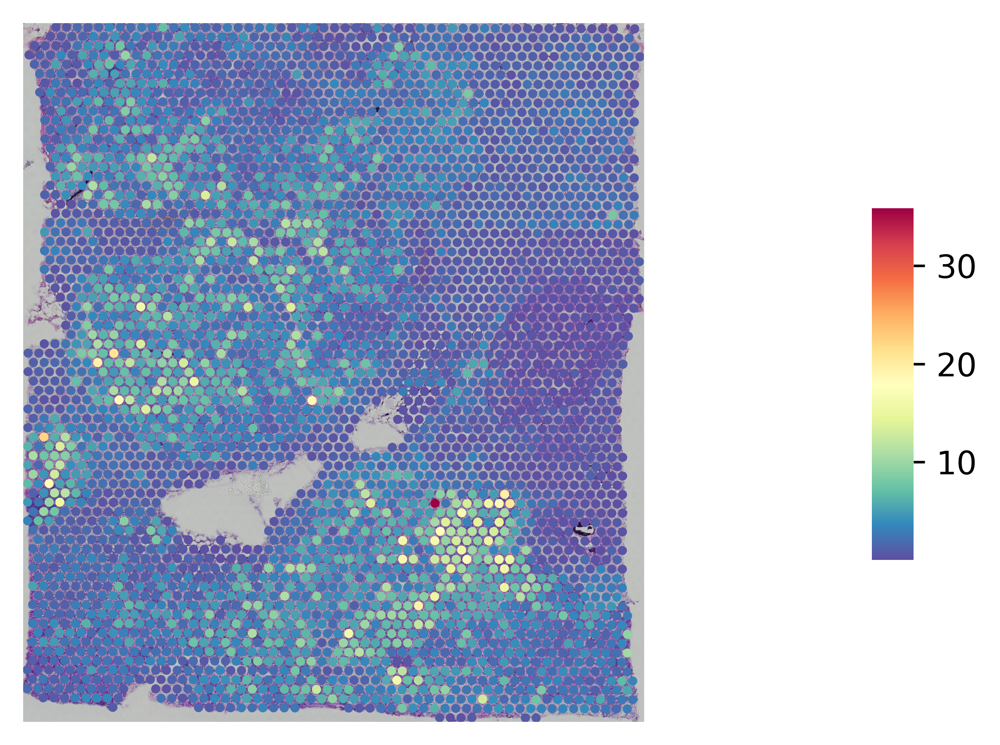

PGM5


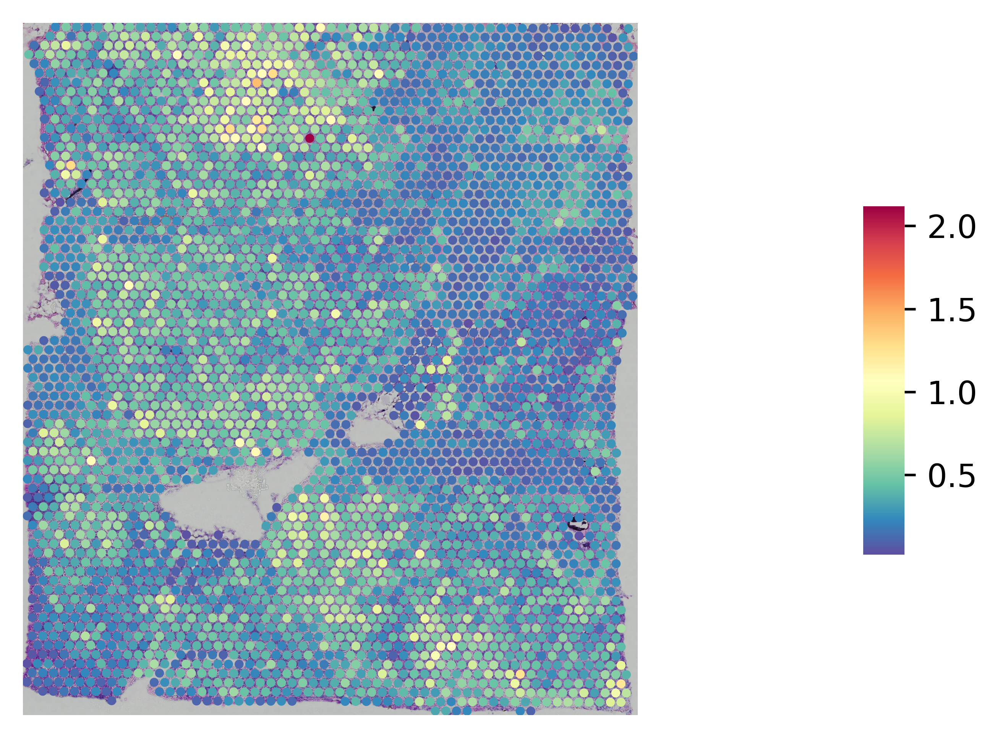

LINC00645


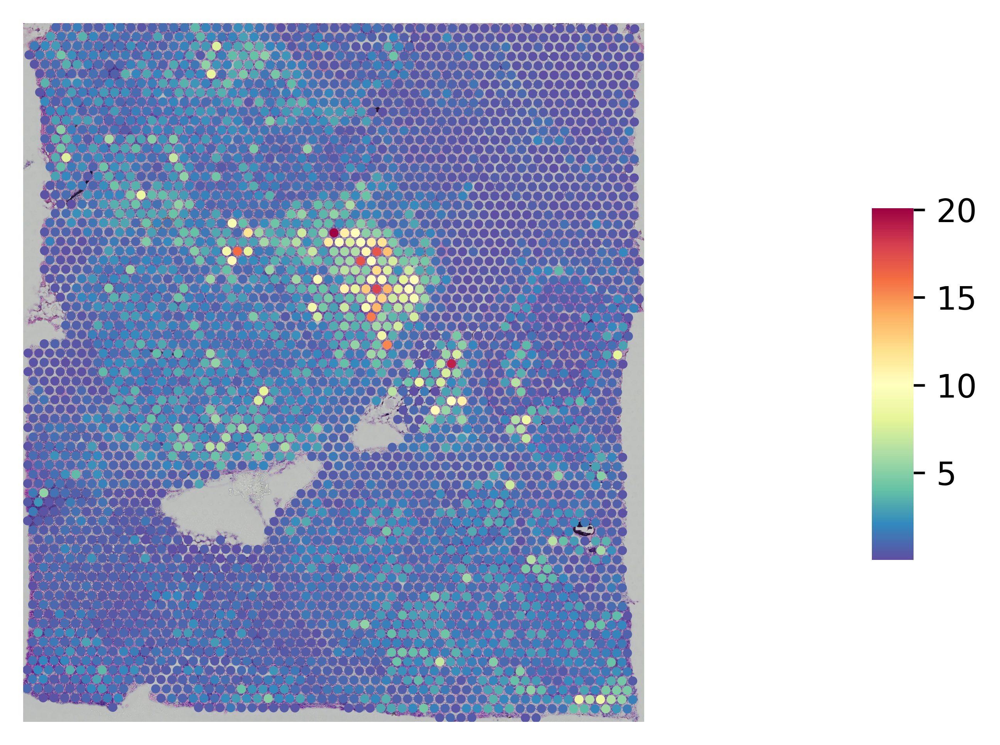

TTLL12


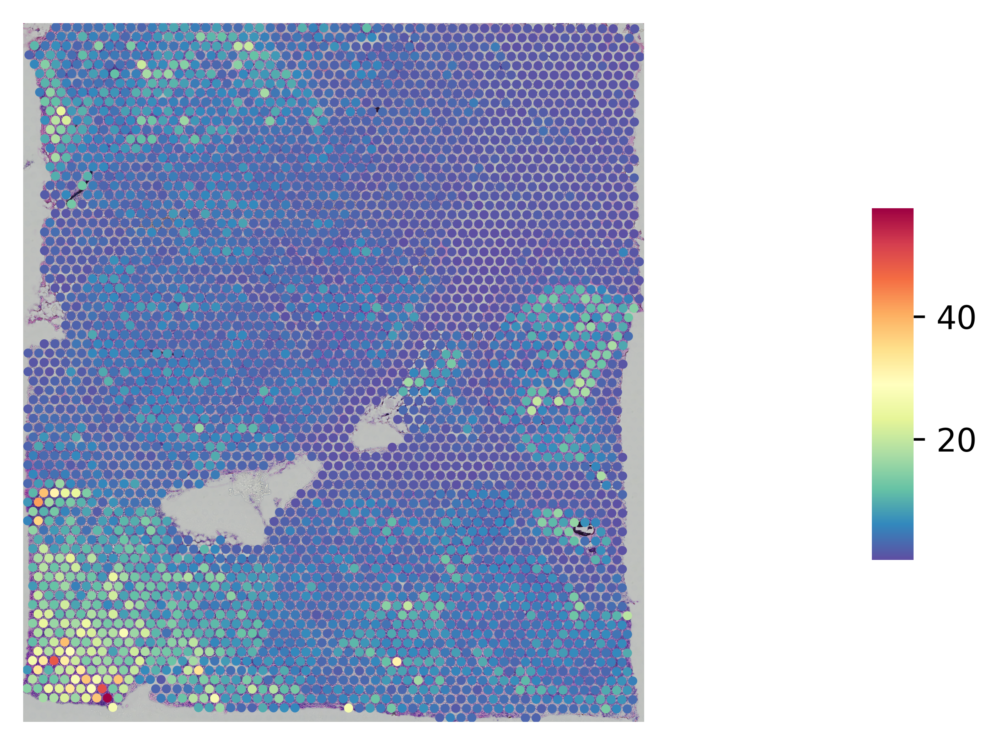

COX6C


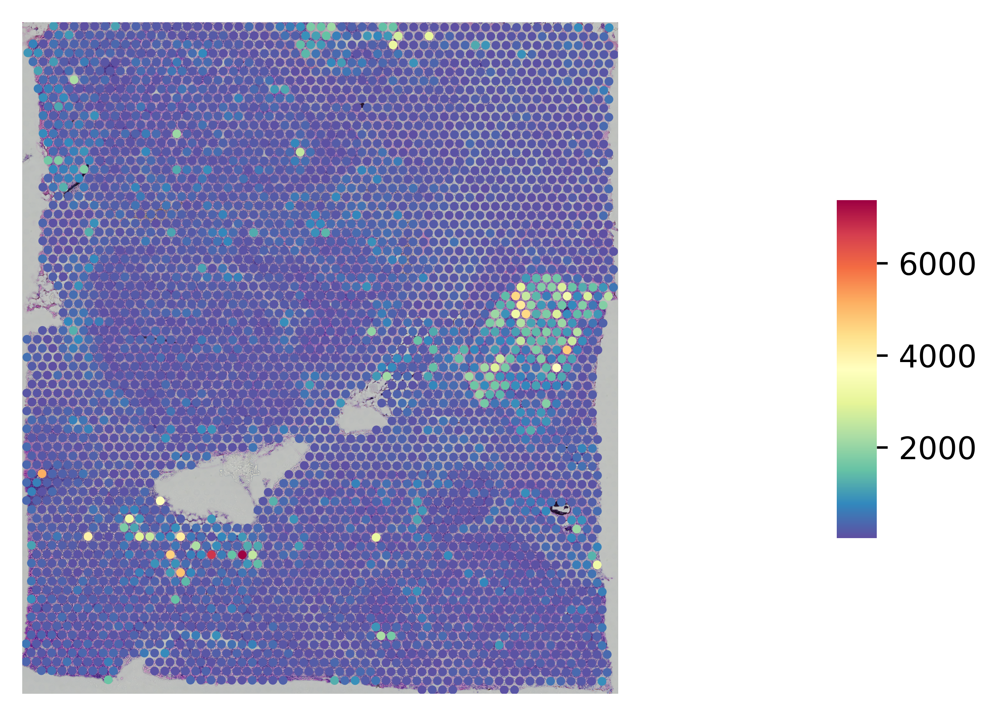

CPB1


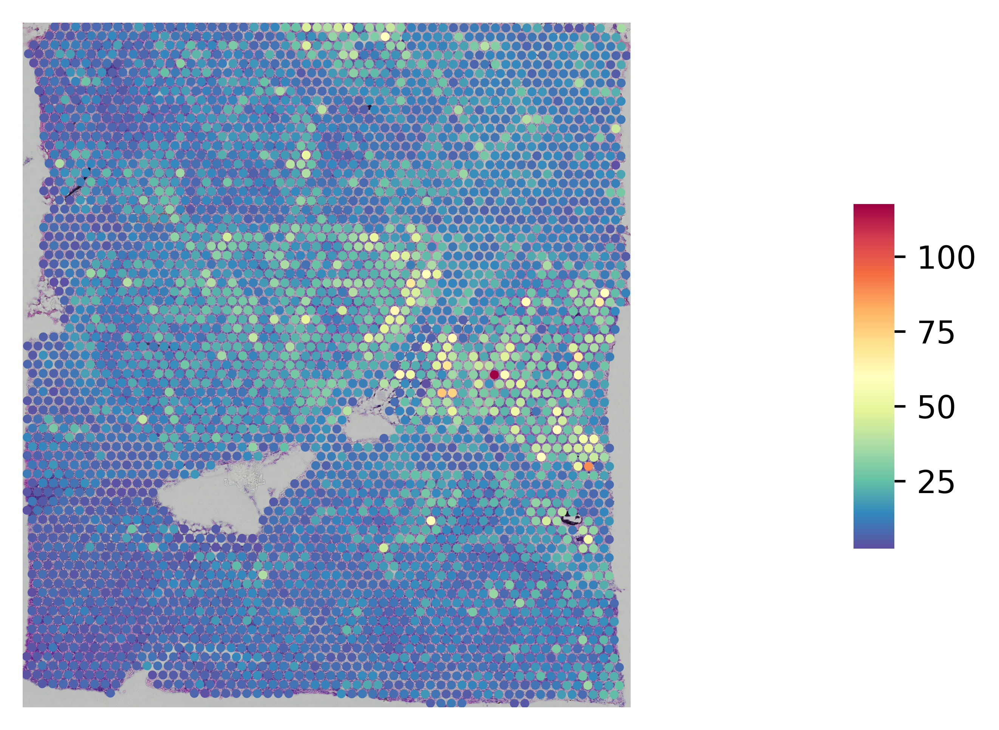

KRT5


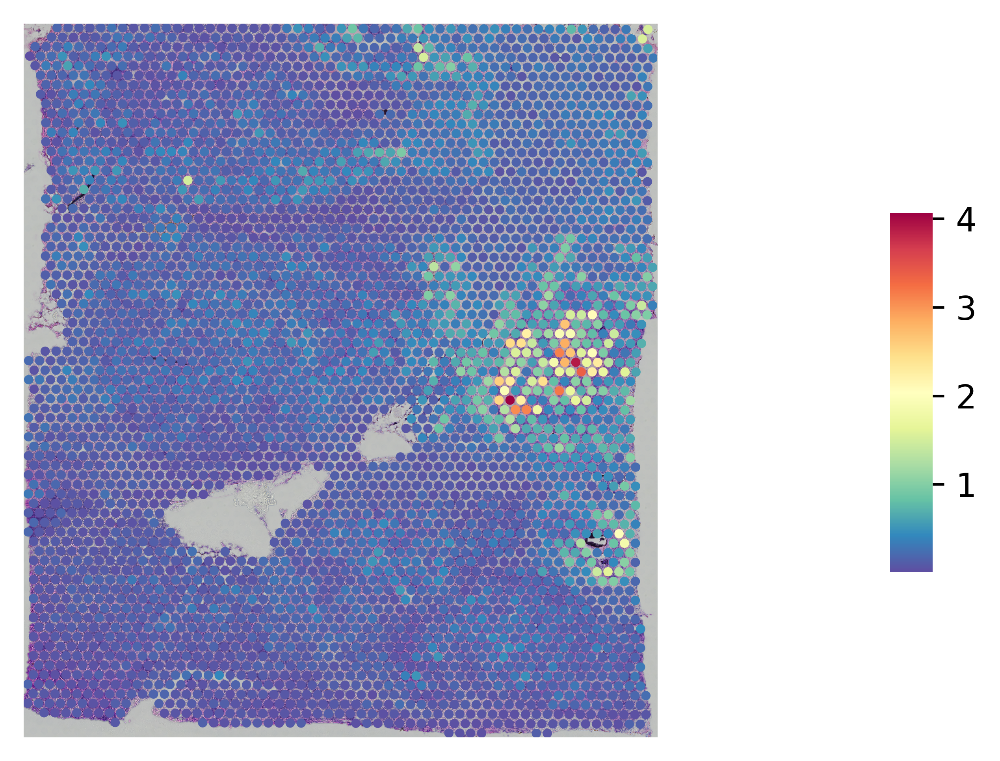

MALAT1


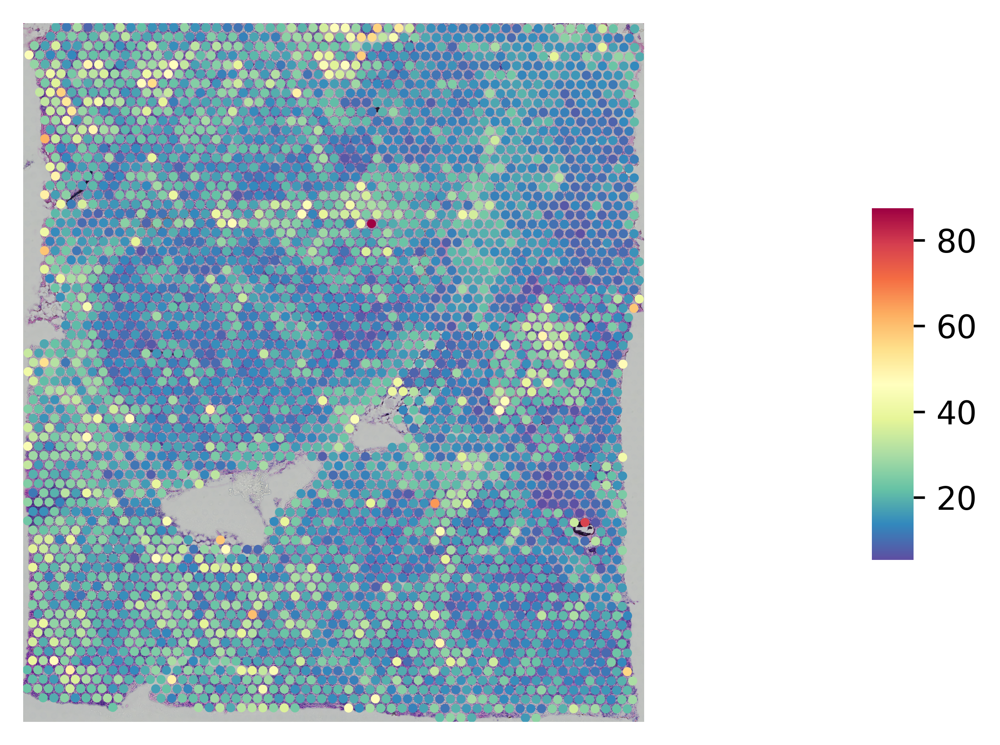

In [48]:
for i in gene_list:
    print(i)
    gene_plot(test_dataset_, genes=i, spot_size=8)

In [11]:
gene_list[4]

'COX6C'

In [12]:
def model_predict_gene(gene):
    i = gene_list.index(gene)
    from scipy.stats import nbinom
    def model_predict(x):
        test_predictions = model.predict(x)
        n = test_predictions[i][:, 0]
        p = test_predictions[i][:, 1]
        y_pred = nbinom.mean(n, p)
        return y_pred.reshape(-1,1)
    return model_predict

In [13]:
from lime import lime_image
explainer = lime_image.LimeImageExplainer()

In [46]:
import skimage
from skimage.color import rgb2hed
from skimage.feature import peak_local_max
from skimage.segmentation import watershed
from skimage.measure import label
import scipy as sp
from scipy import ndimage as ndi
from skimage.morphology import area_opening
import math

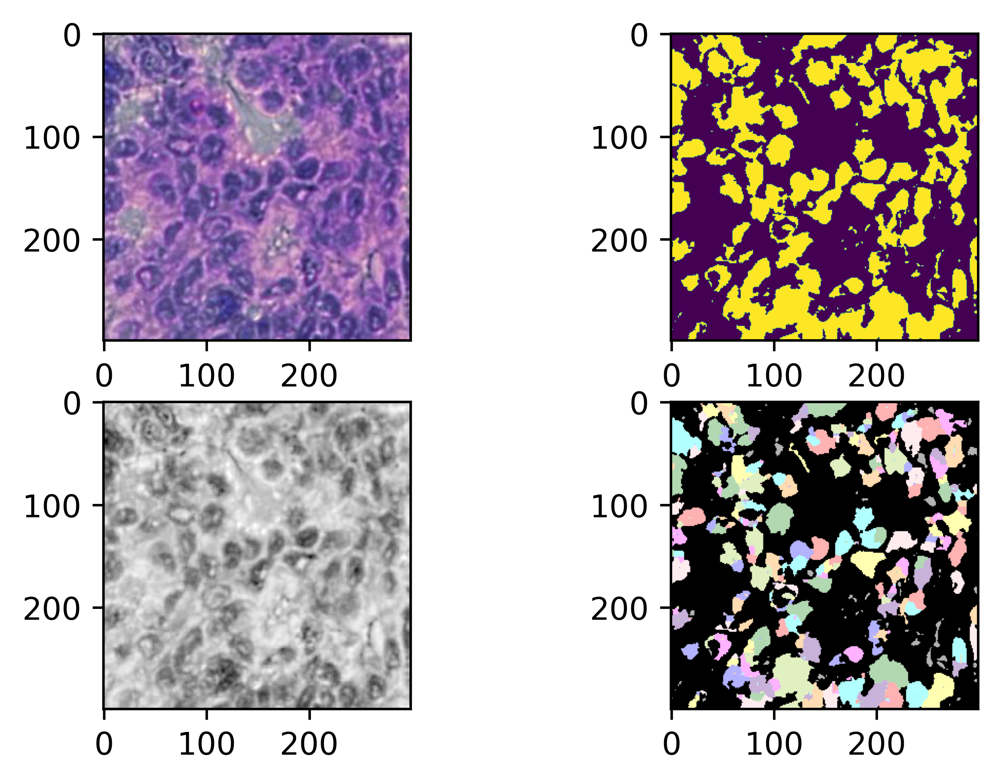

In [15]:
for image, label_ in test_gen.shuffle(200).take(1):
    annotation_hed = rgb2hed(image)
    annotation_h = annotation_hed[:,:,0]
    annotation_h *= 255.0 / np.percentile(annotation_h, q=90)
#     annotation_h = np.clip(annotation_h, a_min=0, a_max=255)
    thresh = skimage.filters.threshold_otsu(annotation_h)
    im_fgnd_mask = sp.ndimage.morphology.binary_fill_holes(
        annotation_h < thresh
    )
    distance = ndi.distance_transform_edt(im_fgnd_mask)
    coords = peak_local_max(distance, footprint=np.ones((3, 3)), labels=im_fgnd_mask)
    mask = np.zeros(distance.shape, dtype=bool)
    mask[tuple(coords.T)] = True
    markers, _ = ndi.label(mask)
    labels = watershed(annotation_h, markers, mask=im_fgnd_mask)
    im_nuclei_seg_mask = area_opening(labels, area_threshold=80).astype(np.int)
    
    fig = plt.figure()
    plt.subplot(2, 2, 1)
    plt.imshow(image.numpy().astype(int))
    plt.subplot(2, 2, 2)
    plt.imshow(im_fgnd_mask)
    plt.subplot(2, 2, 3)
    plt.imshow(annotation_h,cmap="gray")
    plt.subplot(2, 2, 4)
    plt.imshow(image.numpy().astype(int))
    plt.imshow(skimage.color.label2rgb(im_nuclei_seg_mask,
                                       im_fgnd_mask, 
                                       bg_label=0),
               alpha=im_fgnd_mask,
               origin='upper')
    plt.show()

In [30]:
def watershed_segment(image):
    annotation_hed = rgb2hed(image)
    annotation_h = annotation_hed[:,:,0]
    annotation_h *= 255.0 / np.percentile(annotation_h, q=80)
#     annotation_h = np.clip(annotation_h, a_min=0, a_max=255)
    thresh = skimage.filters.threshold_otsu(annotation_h)
    im_fgnd_mask = sp.ndimage.morphology.binary_fill_holes(
        annotation_h < thresh
    )
    distance = ndi.distance_transform_edt(im_fgnd_mask)
    coords = peak_local_max(distance, footprint=np.ones((3, 3)), labels=im_fgnd_mask)
    mask = np.zeros(distance.shape, dtype=bool)
    mask[tuple(coords.T)] = True
    markers, _ = ndi.label(mask)
    labels = watershed(annotation_h, markers, mask=im_fgnd_mask)
    im_nuclei_seg_mask = area_opening(labels, area_threshold=80).astype(np.int)
    return im_nuclei_seg_mask


  0%|          | 0/100 [00:00<?, ?it/s]

prediction: [248.80055237]
ground truth: [1.]


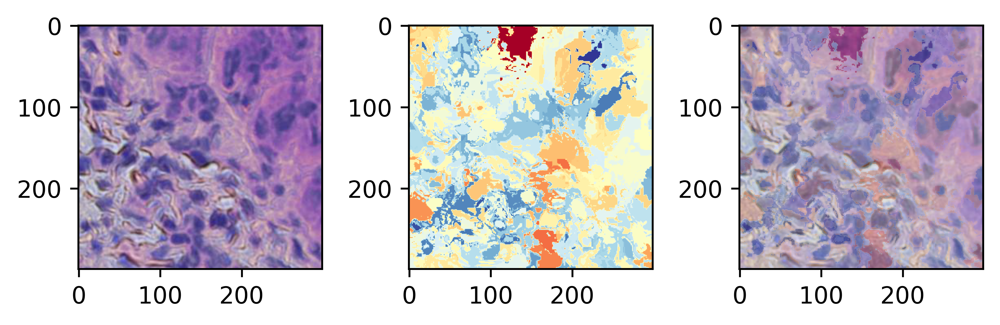

  0%|          | 0/100 [00:00<?, ?it/s]

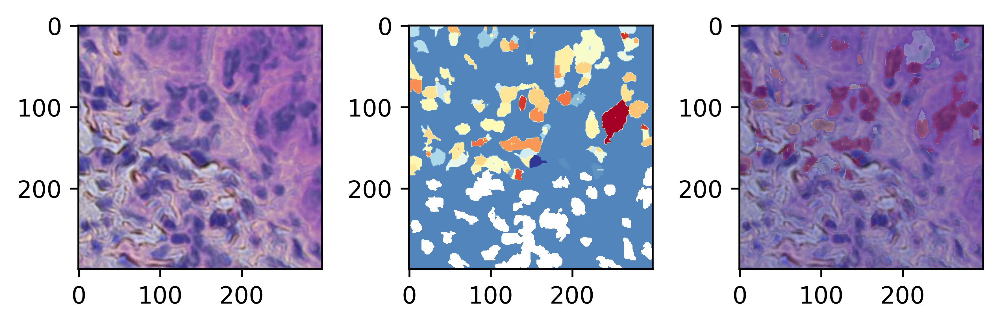

In [52]:
for image, label_ in test_gen.shuffle(200).take(1):
    explanation = explainer.explain_instance(image.numpy().astype("double"), 
                                             model_predict_gene("COX6C"), 
                                             top_labels=1, num_samples=100)
    dict_heatmap1 = dict(explanation.local_exp[explanation.top_labels[0]])
    heatmap1 = np.vectorize(dict_heatmap1.get)(explanation.segments)
    prediction = model_predict_gene("COX6C")(np.expand_dims(image.numpy(), 0)).ravel()
    print("prediction: " + str(prediction))
    print("ground truth: " + str(label_[0].numpy().ravel()))
    fig = plt.figure()
    plt.subplot(1, 3, 1)
    plt.imshow(image.numpy().astype(int))
    plt.subplot(1, 3, 2)
    plt.imshow(heatmap1, alpha=1, cmap = 'RdYlBu_r')
    plt.subplot(1, 3, 3)
    plt.imshow(image.numpy().astype(int))
    plt.imshow(heatmap1, alpha=0.3, cmap = 'RdYlBu_r')
    plt.tight_layout()
    plt.show()
    
    explanation = explainer.explain_instance(image.numpy().astype("double"), 
                                             model_predict_gene("COX6C"), 
                                             top_labels=1, num_samples=100,
                                             num_features=10000,
                                             segmentation_fn=watershed_segment)
    dict_heatmap1 = dict(explanation.local_exp[explanation.top_labels[0]])
    heatmap1 = np.vectorize(dict_heatmap1.get)(explanation.segments)
    fig = plt.figure()
    plt.subplot(2, 3, 4)
    plt.imshow(image.numpy().astype(int))
    plt.subplot(2, 3, 5)
    plt.imshow(heatmap1, alpha=1, cmap = 'RdYlBu_r')
    plt.subplot(2, 3, 6)
    plt.imshow(image.numpy().astype(int))
    plt.imshow(heatmap1, alpha=0.3, cmap = 'RdYlBu_r', vmax=1, vmin=-1)
    plt.tight_layout()
    plt.show()